In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/uber-pickups-in-new-york-city/uber-raw-data-may14.csv
/kaggle/input/uber-pickups-in-new-york-city/other-FHV-services_jan-aug-2015.csv
/kaggle/input/uber-pickups-in-new-york-city/other-Prestige_B01338.csv
/kaggle/input/uber-pickups-in-new-york-city/other-Firstclass_B01536.csv
/kaggle/input/uber-pickups-in-new-york-city/other-Skyline_B00111.csv
/kaggle/input/uber-pickups-in-new-york-city/other-Lyft_B02510.csv
/kaggle/input/uber-pickups-in-new-york-city/uber-raw-data-apr14.csv
/kaggle/input/uber-pickups-in-new-york-city/uber-raw-data-jul14.csv
/kaggle/input/uber-pickups-in-new-york-city/other-Dial7_B00887.csv
/kaggle/input/uber-pickups-in-new-york-city/other-Diplo_B01196.csv
/kaggle/input/uber-pickups-in-new-york-city/other-Federal_02216.csv
/kaggle/input/uber-pickups-in-new-york-city/Uber-Jan-Feb-FOIL.csv
/kaggle/input/uber-pickups-in-new-york-city/uber-raw-data-jun14.csv
/kaggle/input/uber-pickups-in-new-york-city/other-Highclass_B01717.csv
/kaggle/input/uber-pickups-in-ne

In [3]:
apr=pd.read_csv("/kaggle/input/uber-pickups-in-new-york-city/uber-raw-data-apr14.csv")
may=pd.read_csv("/kaggle/input/uber-pickups-in-new-york-city/uber-raw-data-may14.csv")
jun=pd.read_csv("/kaggle/input/uber-pickups-in-new-york-city/uber-raw-data-jun14.csv")
july=pd.read_csv("/kaggle/input/uber-pickups-in-new-york-city/uber-raw-data-jul14.csv")
aug=pd.read_csv("/kaggle/input/uber-pickups-in-new-york-city/uber-raw-data-aug14.csv")
sep=pd.read_csv("/kaggle/input/uber-pickups-in-new-york-city/uber-raw-data-sep14.csv")

In [4]:
from sklearn.cluster import KMeans

In [5]:
apr["Date/Time"]=pd.to_datetime(apr['Date/Time'], format='%m/%d/%Y %H:%M:%S')
may["Date/Time"]=pd.to_datetime(may['Date/Time'], format='%m/%d/%Y %H:%M:%S')
jun["Date/Time"]=pd.to_datetime(jun['Date/Time'], format='%m/%d/%Y %H:%M:%S')
july["Date/Time"]=pd.to_datetime(july['Date/Time'], format='%m/%d/%Y %H:%M:%S')
aug["Date/Time"]=pd.to_datetime(aug['Date/Time'], format='%m/%d/%Y %H:%M:%S')
sep["Date/Time"]=pd.to_datetime(sep['Date/Time'], format='%m/%d/%Y %H:%M:%S')

In [6]:
data=pd.concat([apr,may,jun,july,aug,sep])

In [7]:
data.shape

(4534327, 4)

In [8]:
data['Time'] = data['Date/Time'].dt.time.apply(lambda x: int(x.strftime('%H%M%S')))
data

,Date/Time,Lat,Lon,Base,Time
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,1100
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,1700
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,2100
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,2800
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,3300
...,...,...,...,...,...
1028131,2014-09-30 22:57:00,40.7668,-73.9845,B02764,225700
1028132,2014-09-30 22:57:00,40.6911,-74.1773,B02764,225700
1028133,2014-09-30 22:58:00,40.8519,-73.9319,B02764,225800
1028134,2014-09-30 22:58:00,40.7081,-74.0066,B02764,225800


In [9]:
morning=data[(data["Time"]>70000 )& (data["Time"]<100000)]

In [10]:
morning.shape

(540645, 5)

In [11]:
import folium

In [12]:
morningran=morning.sample(n=10000)

In [13]:
morningran.shape

(10000, 5)

In [14]:
morningran.head()

,Date/Time,Lat,Lon,Base,Time
473213,2014-05-08 08:07:00,40.7993,-73.9702,B02682,80700
174943,2014-06-18 07:35:00,40.7191,-73.9539,B02598,73500
125598,2014-09-12 08:43:00,40.7646,-73.9779,B02598,84300
709298,2014-08-18 09:06:00,40.7740,-73.8717,B02682,90600
674416,2014-08-12 08:00:00,40.6948,-74.1776,B02682,80000


In [15]:
wss=[]
for i in range(1,10):
    model=KMeans(n_clusters=i,init="k-means++")
    model.fit(morningran[["Lat","Lon"]])
    wss.append(model.inertia_)
    
    

In [16]:
%matplotlib inline
import matplotlib.pyplot as plt

Text(0, 0.5, 'Inertia')

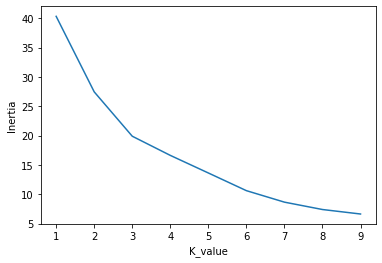

In [17]:
plt.plot(np.arange(1,10),wss)
plt.xlabel("K_value")
plt.ylabel("Inertia")

In [18]:
k=6

In [19]:
modelmorning=KMeans(n_clusters=k)

In [20]:
modelmorning.fit(morningran[["Lat","Lon"]])

KMeans(n_clusters=6)

In [21]:
modelmorning.cluster_centers_

array([[ 40.68291354, -73.74964323],
       [ 40.7053    , -74.20038451],
       [ 40.77415453, -73.9672264 ],
       [ 40.79005371, -73.87390787],
       [ 40.68673266, -73.96471185],
       [ 40.73439823, -73.99438017]])

In [22]:
morningran.head(5)

,Date/Time,Lat,Lon,Base,Time
473213,2014-05-08 08:07:00,40.7993,-73.9702,B02682,80700
174943,2014-06-18 07:35:00,40.7191,-73.9539,B02598,73500
125598,2014-09-12 08:43:00,40.7646,-73.9779,B02598,84300
709298,2014-08-18 09:06:00,40.7740,-73.8717,B02682,90600
674416,2014-08-12 08:00:00,40.6948,-74.1776,B02682,80000


In [23]:
map7to10 = folium.Map(location=[40.7690, -73.9549], zoom_start = 12)
for i in morningran[["Lat","Lon"]].values:
    folium.CircleMarker(radius=1,location=list(i)).add_to(map7to10)

In [24]:
map7to10

In [25]:
centroids=modelmorning.cluster_centers_
    

In [26]:
j=centroids[1]

In [27]:
list(j)

[40.7053, -74.20038450704226]

In [28]:
for centroid in centroids:
    folium.Marker(list(centroid), popup='Centroid {}'.format(list(centroid)), icon=folium.Icon(color='red')).add_to(map7to10)
    

In [29]:
map7to10

In [30]:
ten_to_12=data[(data["Time"]>100000) & (data["Time"]<120000)]

In [31]:
ten_to_12.shape

(322365, 5)

In [32]:
ten_to_12ran=ten_to_12.sample(n=10000)

In [33]:
wss1=[]
for i in range(1,10):
    model=KMeans(n_clusters=i)
    model.fit(ten_to_12ran[["Lat","Lon"]])
    wss1.append(model.inertia_)

Text(0, 0.5, 'Inertia')

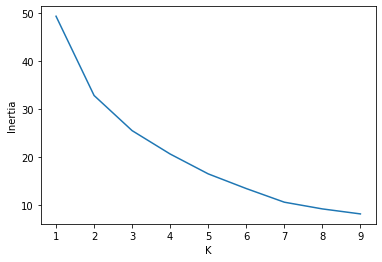

In [36]:
plt.plot(np.arange(1,10),wss1)
plt.xlabel("K")
plt.ylabel("Inertia")

In [37]:
k1=7

In [38]:
ten_to_12model=KMeans(n_clusters=k1)

In [39]:
ten_to_12model.fit(ten_to_12ran[["Lat","Lon"]])

KMeans(n_clusters=7)

In [40]:
centroids10to12=ten_to_12model.cluster_centers_

In [41]:
map10to12 = folium.Map(location=[40.7690, -73.9549], zoom_start = 12)
for i in ten_to_12ran[["Lat","Lon"]].values:
    folium.CircleMarker(radius=1,location=list(i)).add_to(map10to12)

In [42]:
for j in centroids10to12:
    folium.Marker(list(j), popup='Centroid {}'.format(list(j)), icon=folium.Icon(color='red')).add_to(map10to12)
    

In [43]:
map10to12